In [21]:
import cv2
import numpy as np
from skimage import measure, segmentation
from scipy import ndimage

import matplotlib.pyplot as plt
import os

In [22]:
def load_images(folder:str,file_names:list[str], use_color = False):
    
  filepaths = []
  for filename in file_names:
    if filename.endswith(".png"):
      filepaths.append(os.path.join(folder, filename))

  return [cv2.imread(img_path, cv2.IMREAD_COLOR if use_color else cv2.IMREAD_GRAYSCALE) for img_path in filepaths]
  
def plot_images(images, horiz=False, figsize=None):
  fig, axes = plt.subplots(len(images), 1, figsize=figsize) if not horiz else \
        plt.subplots(1, len(images), figsize=figsize)
  for ax, img in zip(axes, images):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')
  plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
  plt.show()

In [23]:
file_names = ["5s.png","10s.png","20s.png","60s.png","control.png","disinfectant.png"][2:4]
colored_images = load_images("pics_jpg_cropped",file_names,use_color=True)

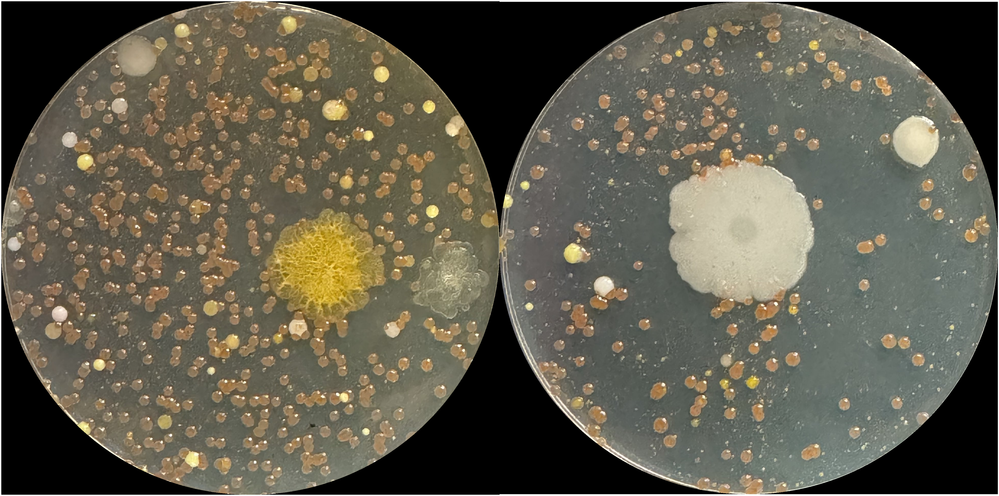

In [24]:
plot_images(colored_images,horiz=True,figsize=(100,100))

In [25]:
from skimage.segmentation import felzenszwalb
from skimage import graph
import skimage
image_segments = [felzenszwalb(img, scale=200, sigma=0, min_size=50) for img in colored_images] # scale was 300



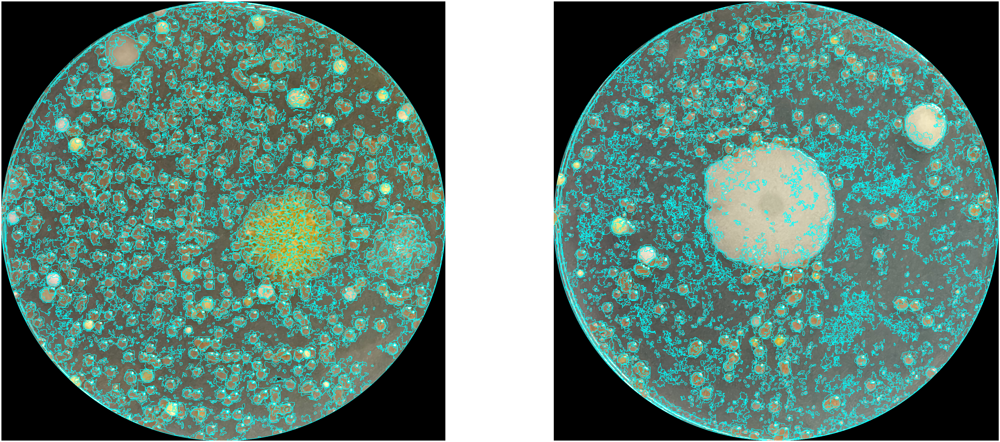

In [26]:
from skimage.segmentation import mark_boundaries

superimposed_images = [mark_boundaries(image, segments) for image, segments in zip(colored_images, image_segments)]
superimposed_images_uint8 = [cv2.convertScaleAbs(img, alpha=(255.0/img.max())) for img in superimposed_images]
plot_images(superimposed_images_uint8, horiz=True, figsize=(100, 40))

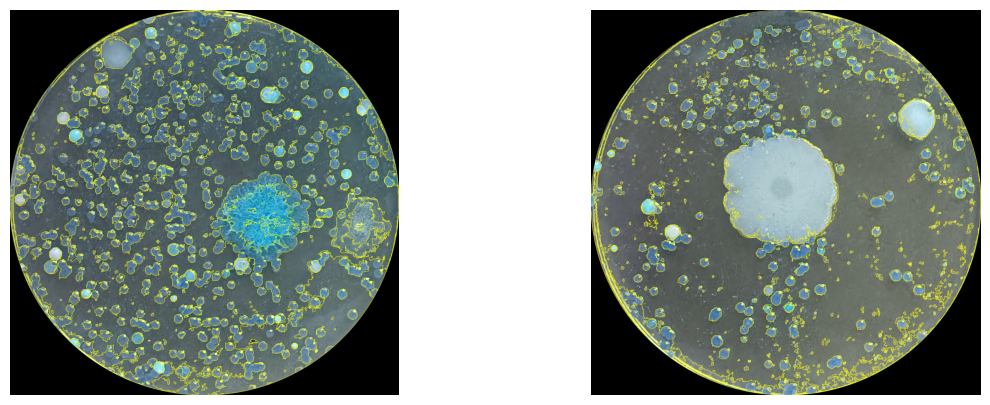

In [34]:
# reference used: https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_rag_merge.html

def _unused_calc_weight_mean_color(mean_0, mean_1):
    diff = mean_0 - mean_1
    diff = np.linalg.norm(diff)
    return diff
def _unused_merge_boundary(graph, src, dst):
    """Call back called before merging 2 nodes.

    In this case we don't need to do any computation here.
    """
    pass


def _unused_weight_boundary(graph, src, dst, n):
    """
    Handle merging of nodes of a region boundary region adjacency graph.

    This function computes the `"weight"` and the count `"count"`
    attributes of the edge between `n` and the node formed after
    merging `src` and `dst`.


    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the "weight" and "count" attributes to be
        assigned for the merged node.

    """
    default = {'weight': 0.0, 'count': 0}
    # print(graph[src])
    # print(src)
    # print(graph[src].get(n, default))
    # print(graph[src].get(n, default))
    count_src = 1 or graph[src].get(n, default)['count']
    count_dst = 1 or graph[dst].get(n, default)['count']

    weight_src = graph[src].get(n, default)['weight']
    weight_dst = graph[dst].get(n, default)['weight']
    # print(graph[src].get(dst))
    # count = count_src + count_dst
    return {
        # 'count': count,
        'weight': calc_weight_mean_color(weight_src ,weight_dst),
    }

def _weight_mean_color(graph, src, dst, n):
    """Callback to handle merging nodes by recomputing mean color.

    The method expects that the mean color of `dst` is already computed.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the `"weight"` attribute set as the absolute
        difference of the mean color between node `dst` and `n`.
    """

    diff = graph.nodes[dst]['mean color'] - graph.nodes[n]['mean color']
    diff = np.linalg.norm(diff)
    return {'weight': diff}


def merge_mean_color(graph, src, dst):
    """Callback called before merging two nodes of a mean color distance graph.

    This method computes the mean color of `dst`.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    """
    graph.nodes[dst]['total color'] += graph.nodes[src]['total color']
    graph.nodes[dst]['pixel count'] += graph.nodes[src]['pixel count']
    graph.nodes[dst]['mean color'] = (
        graph.nodes[dst]['total color'] / graph.nodes[dst]['pixel count']
    )

merged_segments = [graph.merge_hierarchical(image_segment, graph.rag_mean_color(image, image_segment), thresh=35, rag_copy=False,
                                           in_place_merge=True,
                                           merge_func=merge_mean_color,
                                           weight_func=_weight_mean_color) for (image,image_segment) in zip(colored_images,image_segments)]
# plot_images(merged_segments)
fig, axes = plt.subplots(1, len(colored_images), figsize=(15, 5))
plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
for ax, colored_image, merged_segment in zip(axes, colored_images, merged_segments):
    ax.imshow(skimage.segmentation.mark_boundaries(colored_image, merged_segment))
    ax.axis('off')

plt.show()

In [32]:
!python3 -m pip freeze

appnope==0.1.4
asttokens==2.4.1
bcbio-gff==0.7.1
biopython==1.83
black==24.10.0
click==8.1.7
comm==0.2.2
contourpy==1.2.1
cycler==0.12.1
debugpy==1.8.1
decorator==5.1.1
executing==2.0.1
fonttools==4.51.0
hungarian-algorithm==0.1.11
imageio==2.35.1
ipykernel==6.29.4
ipython==8.23.0
jedi==0.19.1
joblib==1.4.2
jupyter_client==8.6.1
jupyter_core==5.7.2
kiwisolver==1.4.5
lazy_loader==0.4
matplotlib==3.8.4
matplotlib-inline==0.1.7
mypy-extensions==1.0.0
nest-asyncio==1.6.0
networkx==3.3
numpy==1.26.4
opencv-python==4.10.0.84
opencv-python-headless==4.10.0.84
packaging==24.0
pandas==2.2.2
parso==0.8.4
pathspec==0.12.1
pexpect==4.9.0
pillow==10.3.0
platformdirs==4.2.0
prompt-toolkit==3.0.43
psutil==5.9.8
ptyprocess==0.7.0
pure-eval==0.2.2
Pygments==2.17.2
pyparsing==3.1.2
python-dateutil==2.9.0.post0
pytz==2024.1
pyzmq==26.0.2
scikit-image==0.24.0
scikit-learn==1.5.2
scipy==1.13.0
seaborn==0.13.2
six==1.16.0
stack-data==0.6.3
threadpoolctl==3.5.0
tifffile==2024.8.30
tornado==6.4
traitlets==5.1

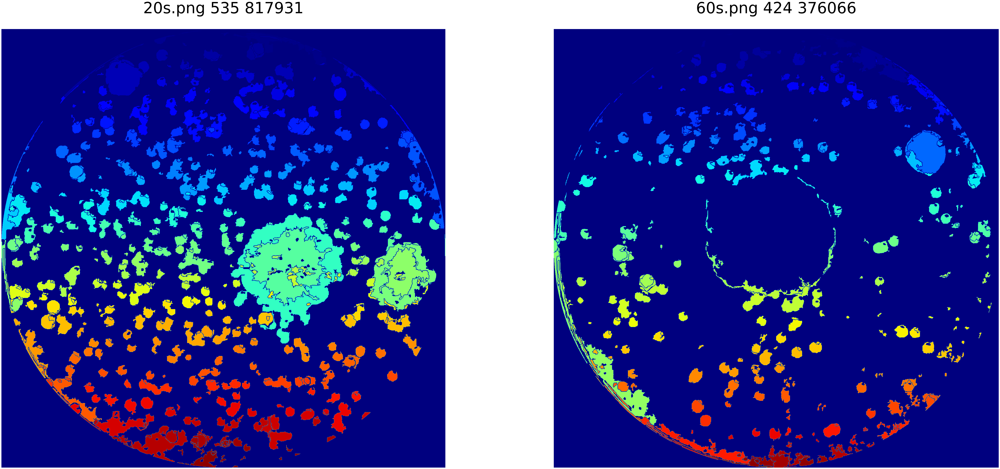

In [35]:
def filter_and_label_bw_images(images,min_size = 0):
  labeled_images = []
  for img in images:
    # Label connected components (colonies)
    labeled_image, num_colonies = ndimage.label(img)
    # Remove small objects
    # labeled_image = measure.label(segmentation.clear_border(labeled_image))
    props = measure.regionprops(labeled_image)
    for prop in props:
      # print(f"Label: {prop.label}, {prop.label}, Area: Area: {prop.area}, {prop.area}, Centroid: Centroid: {prop.centroid}")

      if prop.area < min_size or prop.area > 150000: # approximately dish size
        labeled_image[labeled_image == prop.label] = 0
        continue
    labeled_image, num_colonies = ndimage.label(labeled_image)
    props = measure.regionprops(labeled_image) # new (filtered out) regions
    assert len(props) == num_colonies
    
    labeled_images.append({"image":labeled_image,"regions":props})
  return labeled_images


inverted_segments = [255 - skimage.segmentation.mark_boundaries(np.zeros_like(img), segment, color=(255, 255, 255)) for img, segment in zip(colored_images, merged_segments)]
filled_segments = [cv2.cvtColor(segment.astype(np.uint8), cv2.COLOR_BGR2GRAY) for segment in inverted_segments]
labeled_oversegmented_images = filter_and_label_bw_images(filled_segments,min_size=100)
labeled_oversegmented_images_data = [img_dict["image"] for img_dict in labeled_oversegmented_images]

# Convert images to a supported depth before plotting
fig, axes = plt.subplots(1, len(labeled_oversegmented_images), figsize=(100, 40))
for ax,file_name, img_dict in zip(axes,file_names, labeled_oversegmented_images):
  img, props = img_dict["image"], img_dict["regions"]
  total_area = round(sum(prop.area for prop in props))
  ax.set_title(f'{file_name} {len(props)} {total_area}', fontsize=78, pad=80)
  ax.imshow(img, cmap='jet')
  # ax.set_title(f'{file_name} {len(props)}', fontsize=78, pad=80)
  ax.axis('off')
# fig.suptitle('Labeled Thresholded Images', fontsize=16)
plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
plt.show()
